<a href="https://colab.research.google.com/github/niharika3425/CodeDeployGitHubDemo/blob/main/Metal_Surface_Defect_detection(Real_Original).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Modes:**
train,val,predict

# **Tasks:**

detect,segment,classify

# **Data:**

Format can be different for different task type, Supports data.yaml, data_folder, data_name

# ***Installation***

In [1]:
!nvidia-smi

Sun Jun 22 04:51:19 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   36C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.158 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 41.8/112.6 GB disk)


# *CMD*

In [3]:
!pwd

/content


## Custom Training

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
%cd /content/drive/MyDrive/Colab Notebooks/

/content/drive/MyDrive/Colab Notebooks


In [4]:
!ls

drive


In [6]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="3ue8RYkz7OQ55KTUmd25")
project = rf.workspace("trial-jer7v").project("metal_surface_defects_detection_1.0")
version = project.version(1)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...


# *1. Detection:*

In [7]:
# !pip install wandb
# import wandb

# wandb.require("legacy-service")
!yolo task=detect mode=train model=yolov8x.pt data="/content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/data.yaml" epochs=25 imgsz=200 plots=True

#wandb.require("legacy-service")
#!yolo task=detect mode=train model=yolov8x.pt data="/content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/data.yaml" epochs=25 imgsz=200 plots=True

# import os
# print(os.path.exists("/content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/data.yaml"))


100% 131M/131M [00:00<00:00, 291MB/s]
Ultralytics 8.3.158 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=25, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=200, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8x.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimize

In [8]:
!ls runs/detect/train/

args.yaml			 R_curve.png	      train_batch2.jpg
confusion_matrix_normalized.png  results.csv	      val_batch0_labels.jpg
confusion_matrix.png		 results.png	      val_batch0_pred.jpg
F1_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
labels_correlogram.jpg		 train_batch1095.jpg  val_batch1_pred.jpg
labels.jpg			 train_batch1096.jpg  val_batch2_labels.jpg
P_curve.png			 train_batch1097.jpg  val_batch2_pred.jpg
PR_curve.png			 train_batch1.jpg     weights


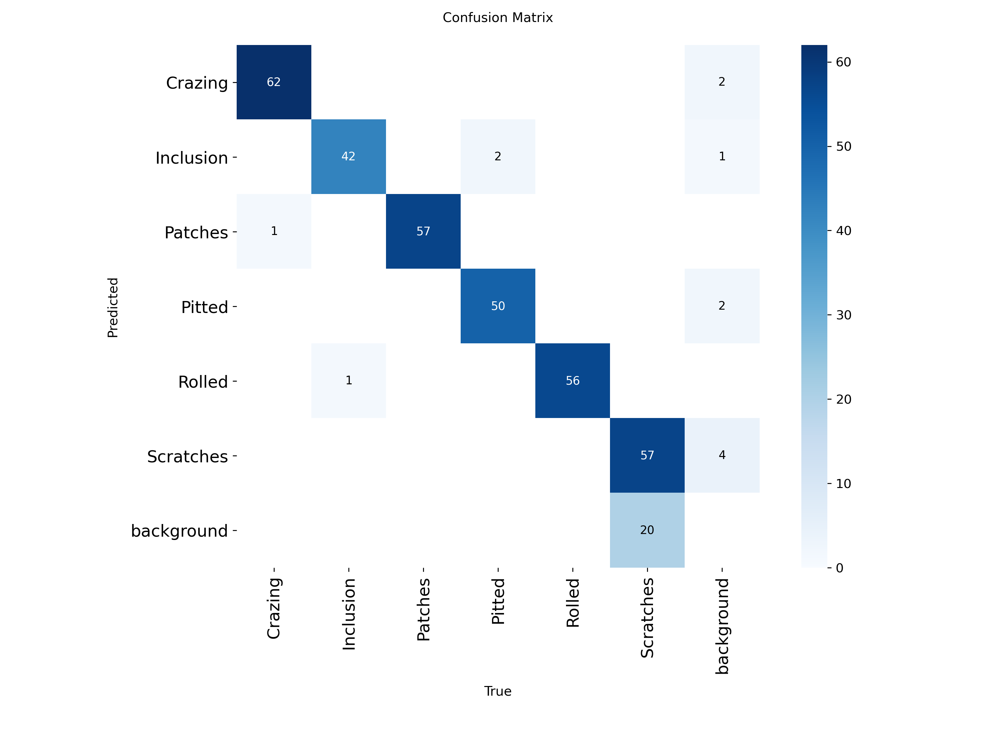

In [9]:
from IPython.display import Image
Image(filename='runs/detect/train/confusion_matrix.png',width=600)

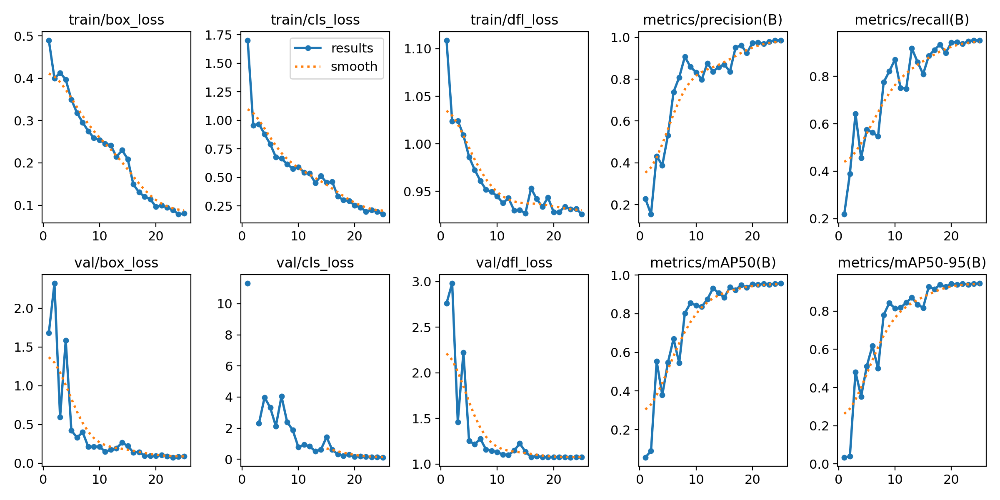

In [10]:
Image(filename='runs/detect/train/results.png', width=600)

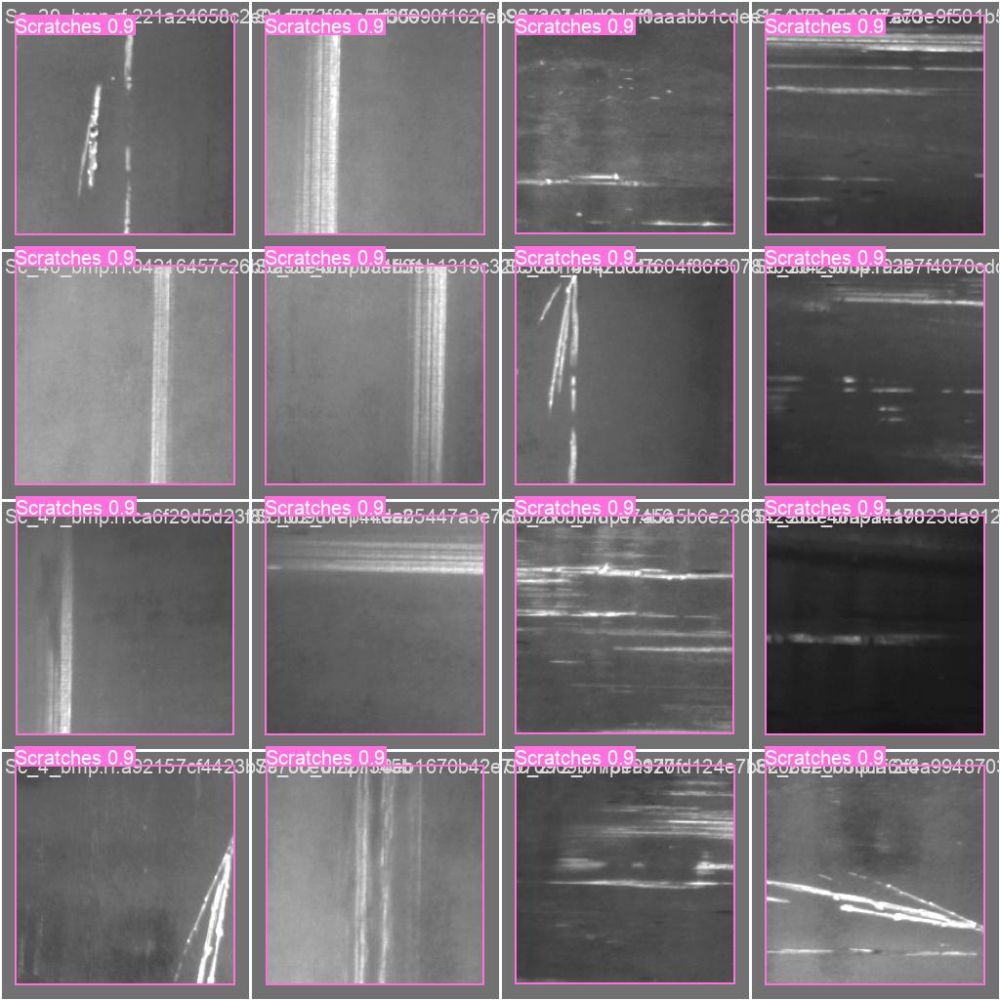

In [14]:
Image(filename='runs/detect/train/val_batch0_pred.jpg', width=600)

# Validate Custom Model

In [16]:
!yolo task=detect mode=val model="/content/drive/MyDrive/Colab Notebooks/runs/detect/train/weights/best.pt" data="/content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/data.yaml" epochs=25 imgsz=200 plots=True

WARNING ⚠️ imgsz=[200] must be multiple of max stride 32, updating to [224]
Ultralytics 8.3.158 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 112 layers, 68,129,346 parameters, 0 gradients, 257.4 GFLOPs
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 26.7±11.0 MB/s, size: 49.1 KB)
val: Scanning /content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/valid/labels.cache... 331 images, 0 backgrounds, 0 corrupt: 100% 331/331 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/valid/images/Cr_35_bmp.rf.a4b5106a408b2d6fc5af3abaaaad8974.jpg: 1 duplicate labels removed
val: WARNING ⚠️ /content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/valid/images/PS_129_bmp.rf.74076eeff597a645d9e73bc3d174d428.jpg: 1 duplicate labels removed
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 21/21 [00:04<00:00,  4.58it/s]
               

## Inference with Custom Mode

In [18]:
#!yolo task=detect mode=predict model="/content/drive/MyDrive/Colab Notebooks/runs/detect/train13/weights/best.pt" conf=0.25 source="/content/drive/MyDrive/Colab Notebooks/WhatsApp Video 2024-10-14 at 21.23.36_0141be21.mp4"

import cv2
import os

# Step 1: Convert the video to grayscale
# Load the original video
video_path = "/content/drive/MyDrive/Colab Notebooks/WhatsApp Video 2024-10-14 at 21.23.36_0141be21.mp4"
grayscale_video_path = "/content/grayscale_video.mp4"  # Save the grayscale video to the Colab environment

# Create a VideoCapture object to read the video
cap = cv2.VideoCapture(video_path)

# Get video properties
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for output video
fps = int(cap.get(cv2.CAP_PROP_FPS))      # Frames per second
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Create a VideoWriter object to write the grayscale video
out = cv2.VideoWriter(grayscale_video_path, fourcc, fps, (width, height), False)  # False indicates grayscale

# Loop through each frame of the video
while True:
    ret, frame = cap.read()
    if not ret:
        break
    # Convert frame to grayscale
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    out.write(gray_frame)  # Write the grayscale frame

# Release video objects
cap.release()
out.release()

# Step 2: Run YOLOv8 on the grayscale video
# Install ultralytics if not already installed
!pip install ultralytics

# Run the YOLOv8 prediction command on the grayscale video
!yolo task=detect mode=predict model="/content/drive/MyDrive/Colab Notebooks/runs/detect/train/weights/best.pt" conf=0.25 source="/content/grayscale_video.mp4"



Ultralytics 8.3.158 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 112 layers, 68,129,346 parameters, 0 gradients, 257.4 GFLOPs

video 1/1 (frame 1/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 51.6ms
video 1/1 (frame 2/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 21.0ms
video 1/1 (frame 3/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 21.0ms
video 1/1 (frame 4/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 20.9ms
video 1/1 (frame 5/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 20.9ms
video 1/1 (frame 6/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 20.9ms
video 1/1 (frame 7/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 16.9ms
video 1/1 (frame 8/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 16.7ms
video 1/1 (frame 9/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 16.7ms
video 1/1 (frame 10/428) /content/grayscale_video.mp4: 224x128 1 Scratches, 16.6ms
video 1/1 (

In [23]:
import os

video_path = '/content/drive/MyDrive/Colab Notebooks/runs/detect/predict38/WhatsApp Video 2024-10-14 at 21.23.36_0141be21.avi'
print(os.path.exists(video_path))  # Should return True if the path is correct

True


In [24]:
from IPython.display import Video

video_path = '/content/drive/MyDrive/Colab Notebooks/runs/detect/predict38/WhatsApp Video 2024-10-14 at 21.23.36_0141be21.avi'
Video(video_path, width=600)
# from IPython.display import Video

# Video(filename='/content/drive/MyDrive/Colab Notebooks/runs/detect/predict22/Metal_Surface_test.avi', width=400)

In [25]:
from IPython.display import HTML
from base64 import b64encode

video_path = '/content/drive/MyDrive/Colab Notebooks/runs/detect/predict38/WhatsApp Video 2024-10-14 at 21.23.36_0141be21.avi'

# Convert the video to base64 for HTML5 video playback
def display_video(video_path):
    mp4 = open(video_path,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return HTML(f"""
      <video width="600" controls>
            <source src="{data_url}" type="video/mp4">
      </video>""")

display_video(video_path)



In [26]:
!ffmpeg -i '/content/drive/MyDrive/Colab Notebooks/runs/detect/predict38/WhatsApp Video 2024-10-14 at 21.23.36_0141be21.avi' output.mp4


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [27]:
display_video('output.mp4')


In [28]:
from ultralytics import YOLO

# Load your trained model (update path as needed)
model = YOLO('/content/drive/MyDrive/Colab Notebooks/runs/detect/train/weights/best.pt')  # or .onnx/.pt

# Run evaluation on the validation dataset (from Roboflow or local)
results = model.val()


Ultralytics 8.3.158 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 112 layers, 68,129,346 parameters, 0 gradients, 257.4 GFLOPs
val: Fast image access ✅ (ping: 0.3±0.1 ms, read: 18.4±8.7 MB/s, size: 33.6 KB)


val: Scanning /content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/valid/labels.cache... 331 images, 0 backgrounds, 0 corrupt: 100%|██████████| 331/331 [00:00<?, ?it/s]

val: WARNING ⚠️ /content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/valid/images/Cr_35_bmp.rf.a4b5106a408b2d6fc5af3abaaaad8974.jpg: 1 duplicate labels removed
val: WARNING ⚠️ /content/drive/MyDrive/Colab Notebooks/Metal-Surface-Defect-Detection-1/valid/images/PS_129_bmp.rf.74076eeff597a645d9e73bc3d174d428.jpg: 1 duplicate labels removed



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 21/21 [00:04<00:00,  4.45it/s]


                   all        331        348      0.986      0.952      0.957      0.946
               Crazing         63         63      0.995          1      0.995      0.995
             Inclusion         43         43          1      0.969      0.995      0.995
               Patches         57         57      0.994          1      0.995      0.995
                Pitted         52         52      0.995          1      0.995      0.995
                Rolled         56         56      0.991          1      0.995      0.995
             Scratches         60         77      0.944       0.74      0.767      0.701
Speed: 0.1ms preprocess, 8.7ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to runs/detect/val2


In [30]:
dir(results.box)


['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'all_ap',
 'ap',
 'ap50',
 'ap_class_index',
 'class_result',
 'curves',
 'curves_results',
 'f1',
 'f1_curve',
 'fitness',
 'map',
 'map50',
 'map75',
 'maps',
 'mean_results',
 'mp',
 'mr',
 'nc',
 'p',
 'p_curve',
 'prec_values',
 'px',
 'r',
 'r_curve',
 'update']

In [33]:
print(f"Precision       : {results.box.p.mean():.4f}")
print(f"Recall          : {results.box.r.mean():.4f}")
print(f"F1 Score        : {results.box.f1.mean():.4f}")
print(f"mAP@0.5         : {results.box.map50:.4f}")
print(f"mAP@0.5:0.95    : {results.box.map:.4f}")
print(f"mAP@0.75        : {results.box.map75:.4f}")


Precision       : 0.9865
Recall          : 0.9516
F1 Score        : 0.9669
mAP@0.5         : 0.9569
mAP@0.5:0.95    : 0.9459
mAP@0.75        : 0.9433
